# Crime_Data
---

## Starter Code to Import Libraries and Load the Crime Data

In [1]:
# Dependencies and Setup
import pandas as pd
import numpy as np
import requests
import json
from sodapy import Socrata

# Import API key
from api_keys import geoapify_key


In [2]:
client = Socrata("data.lacity.org",
                 "OgpnzhFNzTel2Wl6VDDNZJpry",
                 username="julie-kent@bigpond.com",
                 password="BootCamp2023")

# First 2000 results, returned as JSON from API / converted to Python list of
# dictionaries by sodapy.
results = client.get("2nrs-mtv8", limit=10000)

# Convert to pandas DataFrame
results_df = pd.DataFrame.from_records(results)

print(json.dumps(results, indent=4, sort_keys=True))

[
    {
        "area": "03",
        "area_name": "Southwest",
        "crm_cd": "624",
        "crm_cd_1": "624",
        "crm_cd_desc": "BATTERY - SIMPLE ASSAULT",
        "date_occ": "2020-01-08T00:00:00.000",
        "date_rptd": "2020-01-08T00:00:00.000",
        "dr_no": "010304468",
        "lat": "34.0141",
        "location": "1100 W  39TH                         PL",
        "lon": "-118.2978",
        "mocodes": "0444 0913",
        "part_1_2": "2",
        "premis_cd": "501",
        "premis_desc": "SINGLE FAMILY DWELLING",
        "rpt_dist_no": "0377",
        "status": "AO",
        "status_desc": "Adult Other",
        "time_occ": "2230",
        "vict_age": "36",
        "vict_descent": "B",
        "vict_sex": "F",
        "weapon_desc": "STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",
        "weapon_used_cd": "400"
    },
    {
        "area": "01",
        "area_name": "Central",
        "crm_cd": "624",
        "crm_cd_1": "624",
        "crm_cd_desc": "BATTERY 

In [135]:
crime_data_df = pd.DataFrame(results_df)
crime_data_df.count()

dr_no             10000
date_rptd         10000
date_occ          10000
time_occ          10000
area              10000
area_name         10000
rpt_dist_no       10000
part_1_2          10000
crm_cd            10000
crm_cd_desc       10000
mocodes            9097
vict_age          10000
vict_sex           9147
vict_descent       9147
premis_cd         10000
premis_desc        9998
weapon_used_cd     2366
weapon_desc        2366
status            10000
status_desc       10000
crm_cd_1          10000
location          10000
lat               10000
lon               10000
crm_cd_2            579
cross_street       1935
crm_cd_3              8
crm_cd_4              1
dtype: int64

In [136]:
crime_data_df.columns


Index(['dr_no', 'date_rptd', 'date_occ', 'time_occ', 'area', 'area_name',
       'rpt_dist_no', 'part_1_2', 'crm_cd', 'crm_cd_desc', 'mocodes',
       'vict_age', 'vict_sex', 'vict_descent', 'premis_cd', 'premis_desc',
       'weapon_used_cd', 'weapon_desc', 'status', 'status_desc', 'crm_cd_1',
       'location', 'lat', 'lon', 'crm_cd_2', 'cross_street', 'crm_cd_3',
       'crm_cd_4'],
      dtype='object')

In [137]:
crime_data_df.head()

,dr_no,date_rptd,date_occ,time_occ,area,area_name,rpt_dist_no,part_1_2,crm_cd,crm_cd_desc,...,status,status_desc,crm_cd_1,location,lat,lon,crm_cd_2,cross_street,crm_cd_3,crm_cd_4
0,010304468,2020-01-08T00:00:00.000,2020-01-08T00:00:00.000,2230,03,Southwest,0377,2,624,BATTERY - SIMPLE ASSAULT,...,AO,Adult Other,624,1100 W 39TH PL,34.0141,-118.2978,NaN,NaN,NaN,NaN
1,190101086,2020-01-02T00:00:00.000,2020-01-01T00:00:00.000,0330,01,Central,0163,2,624,BATTERY - SIMPLE ASSAULT,...,IC,Invest Cont,624,700 S HILL ST,34.0459,-118.2545,NaN,NaN,NaN,NaN
2,200110444,2020-04-14T00:00:00.000,2020-02-13T00:00:00.000,1200,01,Central,0155,2,845,SEX OFFENDER REGISTRANT OUT OF COMPLIANCE,...,AA,Adult Arrest,845,200 E 6TH ST,34.0448,-118.2474,NaN,NaN,NaN,NaN
3,191501505,2020-01-01T00:00:00.000,2020-01-01T00:00:00.000,1730,15,N Hollywood,1543,2,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),...,IC,Invest Cont,745,5400 CORTEEN PL,34.1685,-118.4019,998,NaN,NaN,NaN
4,191921269,2020-01-01T00:00:00.000,2020-01-01T00:00:00.000,0415,19,Mission,1998,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",...,IC,Invest Cont,740,14400 TITUS ST,34.2198,-118.4468,NaN,NaN,NaN,NaN


In [138]:
# Group by "crm_cd_desc" and count occurrences
grouped = crime_data_df.groupby("crm_cd_desc").size().reset_index(name="count")
grouped.head(20)

,crm_cd_desc,count
0,ARSON,20
1,ASSAULT WITH DEADLY WEAPON ON POLICE OFFICER,8
2,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",318
3,ATTEMPTED ROBBERY,41
4,BATTERY - SIMPLE ASSAULT,622
5,BATTERY ON A FIREFIGHTER,1
6,BATTERY POLICE (SIMPLE),26
7,BATTERY WITH SEXUAL CONTACT,41
8,BIKE - STOLEN,87
9,BOMB SCARE,10


In [139]:
# Sort in descending order by "count"
sorted_grouped = grouped.sort_values(by="count", ascending=False)
sorted_grouped.head(30)

,crm_cd_desc,count
78,THEFT FROM MOTOR VEHICLE - GRAND ($950.01 AND ...,3091
95,VEHICLE - STOLEN,697
4,BATTERY - SIMPLE ASSAULT,622
15,BURGLARY FROM VEHICLE,540
83,THEFT PLAIN - PETTY ($950 & UNDER),454
92,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",443
79,THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER),358
14,BURGLARY,356
2,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",318
81,THEFT OF IDENTITY,294


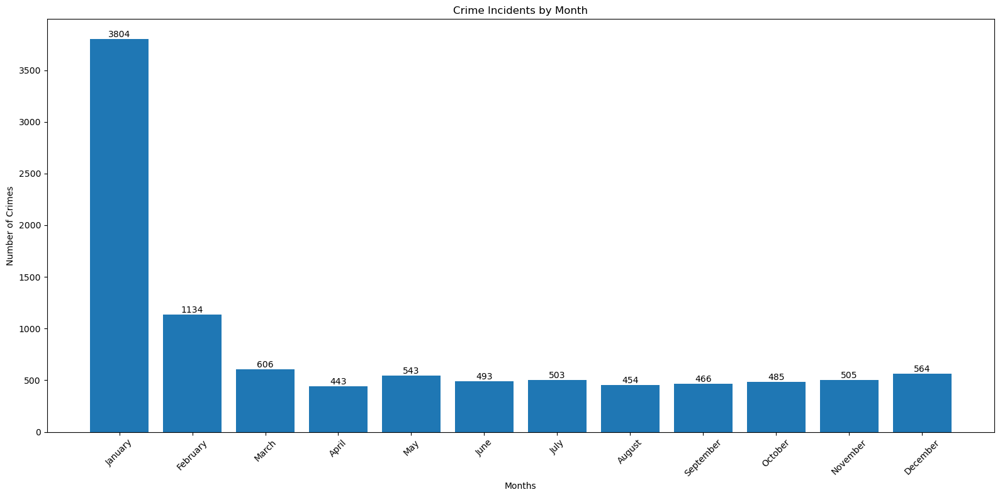

In [140]:
# Convert the "date_occ" column to datetime format
results_df["date_occ"] = pd.to_datetime(results_df["date_occ"])

# Extract the month from the "date_occ" column
results_df["month"] = results_df["date_occ"].dt.month

# Group the data by month and get the count of crimes for each month
crime_count_by_month = results_df["month"].value_counts().sort_index()

# Create a list of month names for labeling the x-axis
month_names = [
    "January", "February", "March", "April", "May", "June",
    "July", "August", "September", "October", "November", "December"
]

# Plot the bar graph
plt.figure(figsize=(16, 8))
bars = plt.bar(crime_count_by_month.index, crime_count_by_month.values)
plt.xticks(crime_count_by_month.index, month_names, rotation=45)
plt.xlabel("Months")
plt.ylabel("Number of Crimes")
plt.title("Crime Incidents by Month")

# Add text annotations for each bar
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height, str(height),
             ha="center", va="bottom")

plt.tight_layout()
plt.show()


Do analysis why is January so high? COVID impact (March OZ States when did they go into lockdown???)

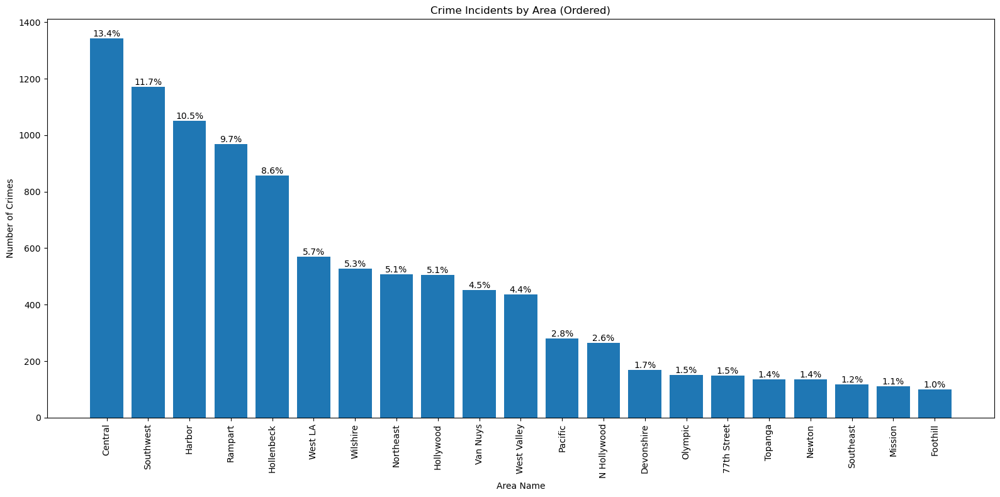

In [141]:
# Group the data by "area_name" and get the total count of crimes for each area
crime_count_by_area = results_df["area_name"].value_counts()

# Sort the data by area name in descending order of crime count
crime_count_by_area = crime_count_by_area.sort_values(ascending=False)

# Calculate the total number of crimes
total_crimes = crime_count_by_area.sum()

# Calculate the percentage of crimes for each area
crime_percentage = (crime_count_by_area / total_crimes) * 100

# Plot the bar chart
plt.figure(figsize=(16, 8))
bars = plt.bar(crime_count_by_area.index, crime_count_by_area.values)
plt.xlabel("Area Name")
plt.ylabel("Number of Crimes")
plt.title("Crime Incidents by Area (Ordered)")
plt.xticks(rotation=90)  # Rotate x-axis labels for better visibility

# Add percentage labels on top of each bar
for bar, percent in zip(bars, crime_percentage):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height, f"{percent:.1f}%", ha="center", va="bottom")

plt.tight_layout()
plt.show()


In [145]:
import hvplot.pandas
import pandas as pd
import requests
import json
import folium  # For creating a map
from geopy.geocoders import Nominatim  # For converting address to latitude and longitude

# Import API key
from api_keys import geoapify_key

# Set up Geoapify API key
api_key = geoapify_key



In [146]:
# ... (Use your previous code to retrieve the data and create the DataFrame)
results_df = pd.DataFrame.from_records(results)

In [148]:
# Drop rows with non-finite (NaN or infinity) values in the lat and lon columns
map_data_cleaned = map_data.dropna(subset=['lat', 'lon']).replace([np.inf, -np.inf], np.nan).dropna()

# Create a map centered at Los Angeles
map_center = [34.0522, -118.2437]
map_LA = folium.Map(location=map_center, zoom_start=11)

# Loop through the DataFrame to add markers for each crime incident
for index, row in map_data_cleaned.iterrows():
    # Extract data for each incident
    date_occ = row['date_occ']
    lat = float(row['lat'])
    lon = float(row['lon'])
    location = row['location']

    # Create a popup message for the marker
    popup_msg = f"Date Occurred: {date_occ}<br>Location: {location}"

    # Add a marker for the incident on the map
    folium.Marker(
        location=[lat, lon],
        popup=popup_msg,
        icon=folium.Icon(color='red', icon='info-sign')
    ).add_to(map_LA)

# Display the map
map_LA

